In [1]:
import pickle
import glob
import os
import re
from matplotlib import pyplot
from typing import Tuple, Optional
import velocity_metrics.spectrum.spectrum as spectrum
import velocity_metrics.lagrangian.cumulative_distance as sde
import matplotlib.pyplot as plt
from plot_GL_metric import plot_lagrangian_result
import gzip 
import os 
import pickle
import numpy as np 

WORKDIR = '/Odyssey/private/t22picar/2024_DC_WOC-ESA/dc_product_evaluation/DC_product_evaluation/'
# Global Variables
idir = os.path.join(WORKDIR, 'spectrum')
base_outputdir = "multivar_drifter/"

base_output="../../"
depth=15
depth_formatted = "{:02}".format(depth)
input_dict = f'{base_output}metric/dictionary/'
input_drifter = "/Odyssey/private/t22picar/data/drifters/AOML/"

drifter_list = [input_drifter + f'Drifters_AOML_GL_{depth_formatted}m_20190101T000000Z_20200101T000000Z.pyo.gz']

input_lagrangian_position = '/Odyssey/private/t22picar/data/drifters/AOML/json/'
region="California"
#path_drifter_position = input_lagrangian_position + f'Fictive_pos_Drifters_AOML_region_{region}_{depth_formatted}m_20190101T000000Z_20200101T000000Z.json' 
path_drifter_param = input_dict + 'drifters_parameters.ini'

xp_name="globcurrent_15m_4th"#"neurost_sst_ssh_15m_10th"
xp_name_2="unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs" #"unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_neurost"

type_metric = "metric_15m"
fictive_traj = f"/Odyssey/private/t22picar/multivar_drifter/rec/{xp_name}/{type_metric}/{region}/{xp_name}_region_{region}_dep1.pyo.gz"
fictive_traj_2=f"/Odyssey/private/t22picar/multivar_drifter/rec/{xp_name_2}/{type_metric}/{region}/{xp_name_2}_region_{region}_dep1.pyo.gz"

if 'gz' in os.path.splitext(drifter_list[0])[-1]:
    with gzip.open(drifter_list[0], 'rb') as f:
        dic_drif = pickle.load(f)



<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [2]:
from plot_lagrangian import get_list_advection,get_sde,get_fictive_traj

from datetime import datetime, timedelta

lld_sum_list = []
keys_list = []
# Définir les dates de début et de fin
start_date = datetime.strptime("2019-03-11", "%Y-%m-%d")
end_date = datetime.strptime("2019-05-21", "%Y-%m-%d")

# Parcourir chaque date dans l'intervalle
current_date = start_date
while current_date <= end_date:
    date_target = current_date.strftime("%Y-%m-%d")
    #print(date_target)  # Ou faites ce que vous voulez avec `date_target`
    current_date += timedelta(days=1)  # Passer à la date suivante


    list_advection, dic_all = get_list_advection(date_target,fictive_traj)

    for advection in list_advection:
        #print(advection)
        sde, lld_sum = get_sde(advection,dic_all,dic_drif)
        #lon_f, lat_f, hrtime, dic_attr,lon_d,lat_d = get_fictive_traj(advection,dic_all,dic_drif)
        lld_sum_list.append(lld_sum)
        keys_list.append(advection)
        
lld_sum_list = np.array(lld_sum_list)
keys_list_ori = np.array(keys_list)


number of drifter : 9
number of drifter : 10
number of drifter : 8
number of drifter : 9
number of drifter : 9
number of drifter : 11
number of drifter : 9
number of drifter : 10
number of drifter : 10
number of drifter : 11
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 11
number of drifter : 11
number of drifter : 10
number of drifter : 10
number of drifter : 11
number of drifter : 11
number of drifter : 11
number of drifter : 11
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 11
number of drifter : 10
number of drifter : 8
number of drifter : 7
number of drifter : 7
number of drifter : 7
number of drifter : 8
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 10
number of drifter : 7

In [3]:
lld_sum_list

array([30.12315788, 53.73289037, 30.48065332, 15.18898914, 32.83197509,
       31.40934013, 41.76232715, 21.12697277, 25.616013  , 29.90069298,
       53.77408397, 30.91367307, 15.95522631, 35.2987083 , 21.80506421,
       28.88589056, 47.26943766, 20.68159345, 27.57197973, 29.28317878,
       33.58212761, 16.56230385, 36.76742467, 28.1959536 , 49.94220308,
       18.98595817, 29.22019196, 26.67450667, 31.13842345, 17.64124075,
       36.11624093, 27.99269951, 30.10813249, 52.55442891, 18.76718447,
       29.19255294, 25.73856711, 56.46074897, 29.14909078, 18.07049265,
       36.29252091, 28.66452992, 56.46563787, 20.06691539, 28.46057826,
       28.07780348, 62.99275776, 30.90771287, 17.77801141, 34.69098586,
       15.7055027 , 27.10263006, 28.21666731, 57.70271783, 21.14720628,
       26.99540365, 29.65141542, 65.46253962, 36.30497199, 16.07551675,
       33.2612426 , 25.4487121 , 59.65987158, 22.61345061, 24.89005321,
       30.10971136, 56.65129137, 42.52340992, 17.23429977, 37.55

In [4]:
keys_list = keys_list_ori[np.argwhere(lld_sum_list > 100)]
keys_list

array([], shape=(0, 1), dtype='<U49')

In [96]:
list_stat = ('meansde', 'stdsde', 'minsde', 'maxsde', 'mediansde')

ifile="/Odyssey/private/t22picar/multivar_drifter/rec/unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs/metric_15m/Agulhas/plot/SDE_region_Agulhas_20190101-20191231_unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs.pyo.gz"
if 'gz' in os.path.splitext(ifile)[-1]:
    with gzip.open(ifile, 'rb') as f:
        dic_imt = pickle.load(f)

ifile="/Odyssey/private/t22picar/multivar_drifter/rec/globcurrent_15m_4th/metric_15m/Agulhas/plot/SDE_region_Agulhas_20190101-20191231_globcurrent_15m_4th.pyo.gz"
if 'gz' in os.path.splitext(ifile)[-1]:
    with gzip.open(ifile, 'rb') as f:
        dic_gc = pickle.load(f)

In [97]:
# filtrage > 100km
maxsde_imt = np.array([[value["maxsde"][-1]] for key, value in dic_imt.items() if key in keys_list])
maxsde_gc = np.array([[value["maxsde"][-1]] for key, value in dic_gc.items() if key in keys_list])
keys = [[key] for key, value in dic_imt.items() if key in keys_list]

diff_maxsde = maxsde_imt - maxsde_gc
print(np.mean(diff_maxsde))

0.03436800072574583


In [98]:
# filtrage > 100km
meansde_imt = np.array([[value["meansde"][-1]] for key, value in dic_imt.items() if key in keys_list])
meansde_gc = np.array([[value["meansde"][-1]] for key, value in dic_gc.items() if key in keys_list])
keys = [[key] for key, value in dic_imt.items() if key in keys_list]
diff_meansde = meansde_imt - meansde_gc
print(np.mean(diff_meansde))

0.02683508604251072


In [102]:
diff_meansde

array([[ 0.05325379],
       [ 0.00029561],
       [-0.009058  ],
       [ 0.09601459],
       [ 0.12341982],
       [ 0.07542958],
       [-0.00436492],
       [-0.01790532],
       [-0.01121291],
       [-0.00727268],
       [-0.00341361]])

In [99]:
keys

[['000000001701558_20190411T030000Z_20190421T030000Z'],
 ['000000001701558_20190412T030000Z_20190422T030000Z'],
 ['000000001701558_20190413T030000Z_20190423T030000Z'],
 ['000000001701558_20190414T030000Z_20190424T030000Z'],
 ['000000001701558_20190415T030000Z_20190425T030000Z'],
 ['000000001701558_20190416T030000Z_20190426T030000Z'],
 ['000000001701558_20190417T030000Z_20190427T030000Z'],
 ['000000001701558_20190418T030000Z_20190428T030000Z'],
 ['000000001701558_20190419T030000Z_20190429T030000Z'],
 ['000000001701558_20190420T030000Z_20190430T030000Z'],
 ['000000001701558_20190421T030000Z_20190501T030000Z']]

In [100]:
meansde_imt

array([[0.33567629],
       [0.29574428],
       [0.33304204],
       [0.42753917],
       [0.44169753],
       [0.34901239],
       [0.24225432],
       [0.24861046],
       [0.22410833],
       [0.20345463],
       [0.20906581]])

In [68]:
keys[np.argmax(diff_maxsde)]

['000000001701558_20190411T030000Z_20190421T030000Z']

In [41]:
np.mean(diff_maxsde)

np.float64(-0.0588029584321305)

In [ ]:

maxsde = np.array([[value["maxsde"][-1]] for key, value in dic_imt.items()])
keys = [[key] for key, value in dic_imt.items()]

In [47]:
diff_maxsde = np.abs(np.array([[value["maxsde"][-1]] for key, value in dic_imt.items()])-np.array([[value["maxsde"][-1]] for key, value in dic_gc.items()]))
keys = [[key] for key, value in dic_imt.items()]

In [49]:
sorted_keys = [key for _, key in sorted(zip(diff_maxsde, keys), reverse=True)]

In [50]:
sorted_keys

[['000000001701560_20190423T000000Z_20190503T000000Z'],
 ['000000001701560_20190425T000000Z_20190505T000000Z'],
 ['000000001701560_20190422T000000Z_20190502T000000Z'],
 ['000000001701569_20190713T080000Z_20190723T080000Z'],
 ['000000001701570_20190713T150000Z_20190723T150000Z'],
 ['000000001701570_20190714T150000Z_20190724T150000Z'],
 ['000000001701569_20190714T080000Z_20190724T080000Z'],
 ['000000001701560_20190327T000000Z_20190406T000000Z'],
 ['000000001701570_20190715T150000Z_20190725T150000Z'],
 ['000000001701561_20190402T140000Z_20190412T140000Z'],
 ['000000001701570_20190710T150000Z_20190720T150000Z'],
 ['000000001701569_20190715T080000Z_20190725T080000Z'],
 ['000000001601623_20191104T000000Z_20191114T000000Z'],
 ['000000001701561_20190919T230000Z_20190929T230000Z'],
 ['000000001701560_20190410T000000Z_20190420T000000Z'],
 ['000000001701562_20190326T020000Z_20190405T020000Z'],
 ['000000001601621_20190624T060000Z_20190704T060000Z'],
 ['000000003101537_20191120T020000Z_20191130T020

In [48]:
keys[np.argmax(diff_maxsde)]


['000000001701560_20190423T000000Z_20190503T000000Z']

In [ ]:
for key, value in dic.items():
    print(value["maxsde"][-1])
    #print(key)

0.9602669447805354
000000001701556_20190315T080000Z_20190325T080000Z
0.853674631462973
000000001701556_20190316T080000Z_20190326T080000Z
0.9490924650135744
000000001701556_20190317T080000Z_20190327T080000Z
0.8088846949633203
000000001701556_20190318T080000Z_20190328T080000Z
0.2745137378334126
000000001701556_20190319T080000Z_20190329T080000Z
1.1118402319866039
000000001701556_20190320T080000Z_20190330T080000Z
0.951522413092961
000000001701556_20190321T080000Z_20190331T080000Z
0.917613000845506
000000001701556_20190322T080000Z_20190401T080000Z
1.183217558284272
000000001701556_20190323T080000Z_20190402T080000Z
1.6950493980689993
000000001701556_20190324T080000Z_20190403T080000Z
2.4442409116265424
000000001701556_20190325T080000Z_20190404T080000Z
2.6162744748820894
000000001701556_20190326T080000Z_20190405T080000Z
2.0272895016434886
000000001701556_20190327T080000Z_20190406T080000Z
0.42919377578199586
000000001701556_20190328T080000Z_20190407T080000Z
0.5806110890381944
000000001701556_20

In [9]:
dic.items()

dict_items([('000000001701556_20190315T080000Z_20190325T080000Z', {'time': array([ 0. ,  0.2,  0.4,  0.6,  0.8,  1. ,  1.2,  1.4,  1.6,  1.8,  2. ,
        2.2,  2.4,  2.6,  2.8,  3. ,  3.2,  3.4,  3.6,  3.8,  4. ,  4.2,
        4.4,  4.6,  4.8,  5. ,  5.2,  5.4,  5.6,  5.8,  6. ,  6.2,  6.4,
        6.6,  6.8,  7. ,  7.2,  7.4,  7.6,  7.8,  8. ,  8.2,  8.4,  8.6,
        8.8,  9. ,  9.2,  9.4,  9.6,  9.8, 10. ]), 'meansde': array([0.        , 0.        ,        nan, 1.46073877, 0.95575019,
       0.79503277, 0.71242745, 0.66097036, 0.62394683, 0.59651259,
       0.57336123, 0.55787242, 0.5438616 , 0.52799576, 0.51070051,
       0.49440265, 0.48069982, 0.47036061, 0.46253248, 0.45659881,
       0.45252825, 0.44983909, 0.44754171, 0.44525147, 0.44303574,
       0.44107014, 0.43881884, 0.4364229 , 0.43399096, 0.43169605,
       0.42937839, 0.42703782, 0.42462525, 0.42197781, 0.41920943,
       0.41640159, 0.41352534, 0.41048021, 0.40721721, 0.40370411,
       0.39993907, 0.39597399, 0.39

In [8]:
dic

{'000000001701556_20190315T080000Z_20190325T080000Z': {'time': array([ 0. ,  0.2,  0.4,  0.6,  0.8,  1. ,  1.2,  1.4,  1.6,  1.8,  2. ,
          2.2,  2.4,  2.6,  2.8,  3. ,  3.2,  3.4,  3.6,  3.8,  4. ,  4.2,
          4.4,  4.6,  4.8,  5. ,  5.2,  5.4,  5.6,  5.8,  6. ,  6.2,  6.4,
          6.6,  6.8,  7. ,  7.2,  7.4,  7.6,  7.8,  8. ,  8.2,  8.4,  8.6,
          8.8,  9. ,  9.2,  9.4,  9.6,  9.8, 10. ]),
  'meansde': array([0.        , 0.        ,        nan, 1.46073877, 0.95575019,
         0.79503277, 0.71242745, 0.66097036, 0.62394683, 0.59651259,
         0.57336123, 0.55787242, 0.5438616 , 0.52799576, 0.51070051,
         0.49440265, 0.48069982, 0.47036061, 0.46253248, 0.45659881,
         0.45252825, 0.44983909, 0.44754171, 0.44525147, 0.44303574,
         0.44107014, 0.43881884, 0.4364229 , 0.43399096, 0.43169605,
         0.42937839, 0.42703782, 0.42462525, 0.42197781, 0.41920943,
         0.41640159, 0.41352534, 0.41048021, 0.40721721, 0.40370411,
         0.39993907, 0.

<Figure size 640x480 with 0 Axes>

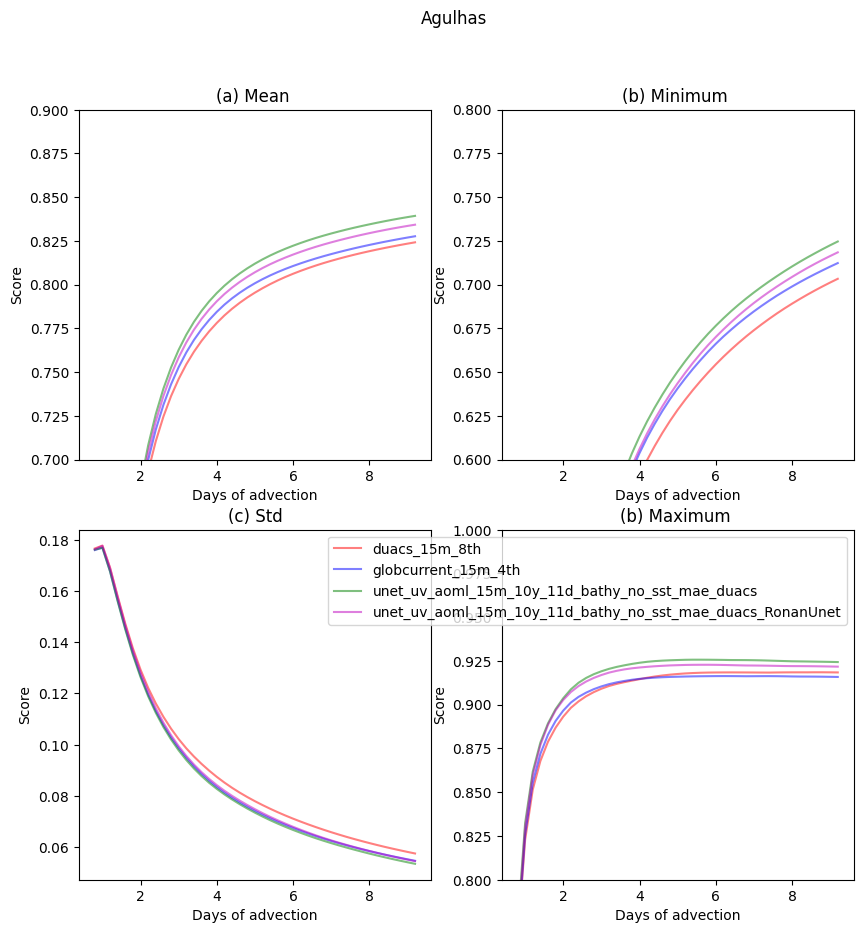

<Figure size 640x480 with 0 Axes>

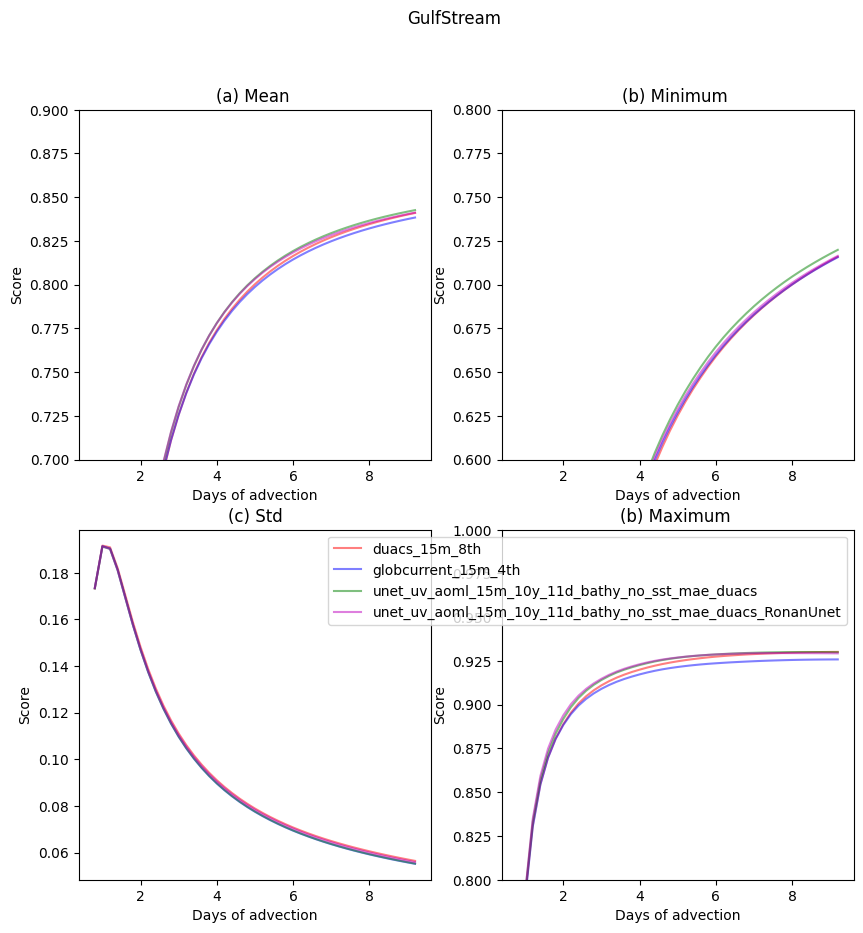

<Figure size 640x480 with 0 Axes>

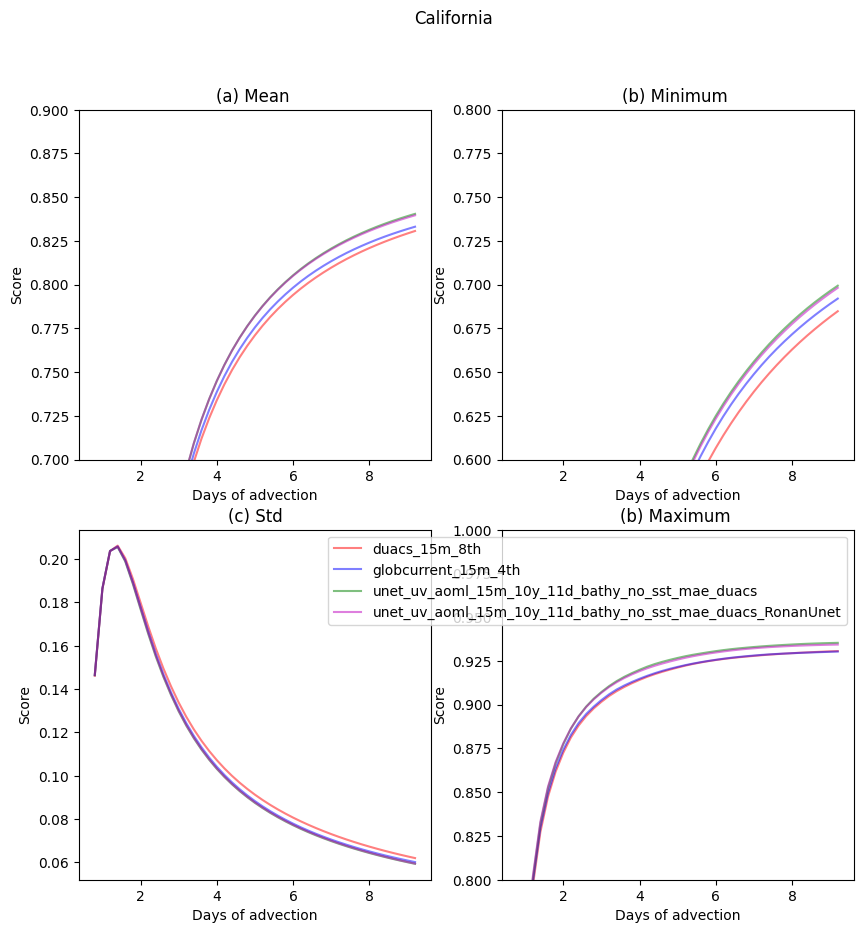

In [4]:
list_region=["Agulhas","GulfStream","California"]


list_xp_name=[  "duacs_15m_8th",
                "globcurrent_15m_4th",
                "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs",
                "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs_RonanUnet"
                ]

plot_lagrangian_result(list_xp_name,list_region,depth=15)

FileNotFoundError: [Errno 2] No such file or directory: '..//rec/unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs_RonanUnet/metric_15m/NA/plot/SDE_region_NA_20190101-20191231_unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs_RonanUnet.pyo.gz'

<Figure size 640x480 with 0 Axes>

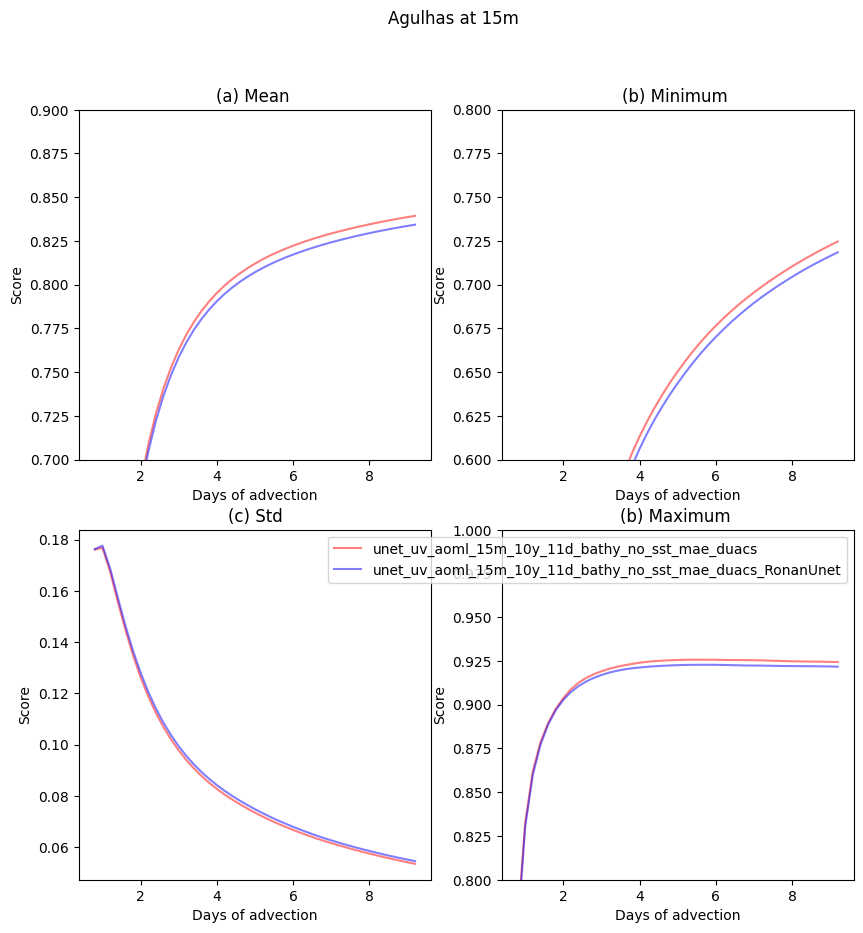

<Figure size 640x480 with 0 Axes>

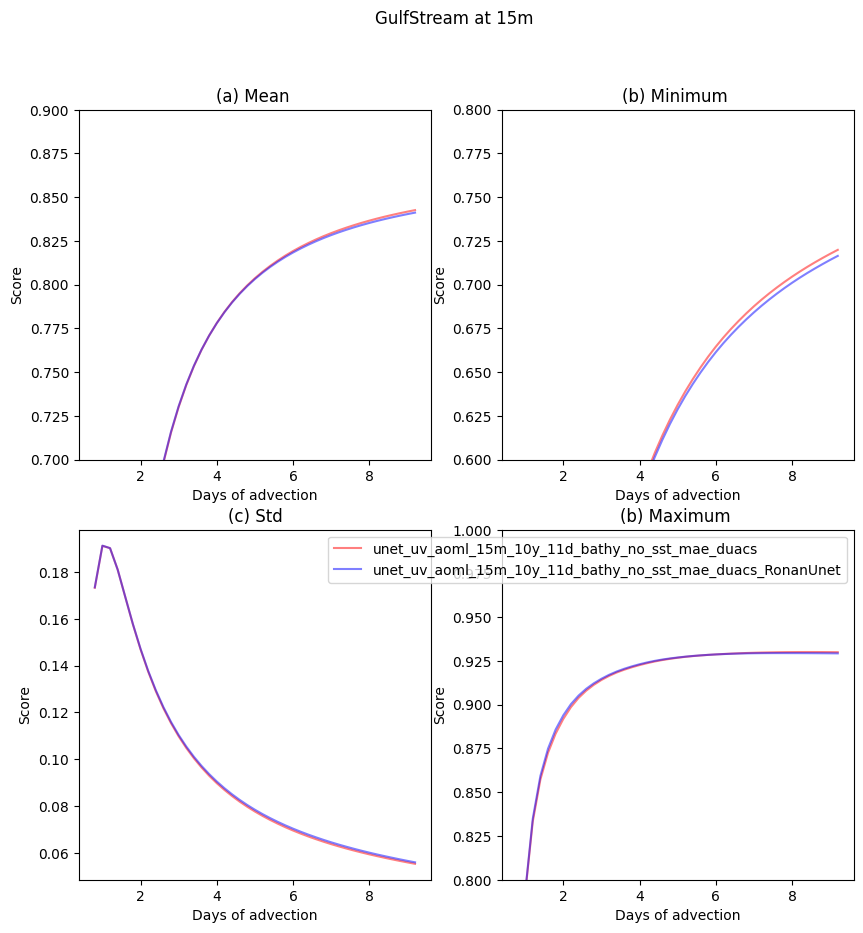

<Figure size 640x480 with 0 Axes>

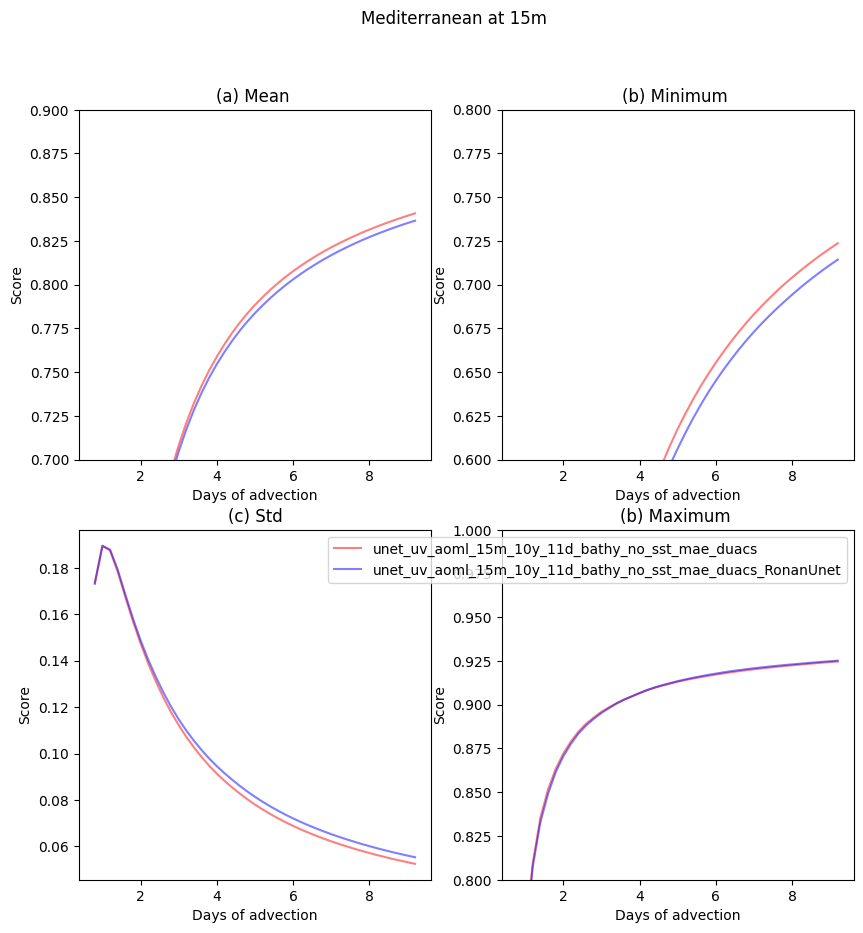

<Figure size 640x480 with 0 Axes>

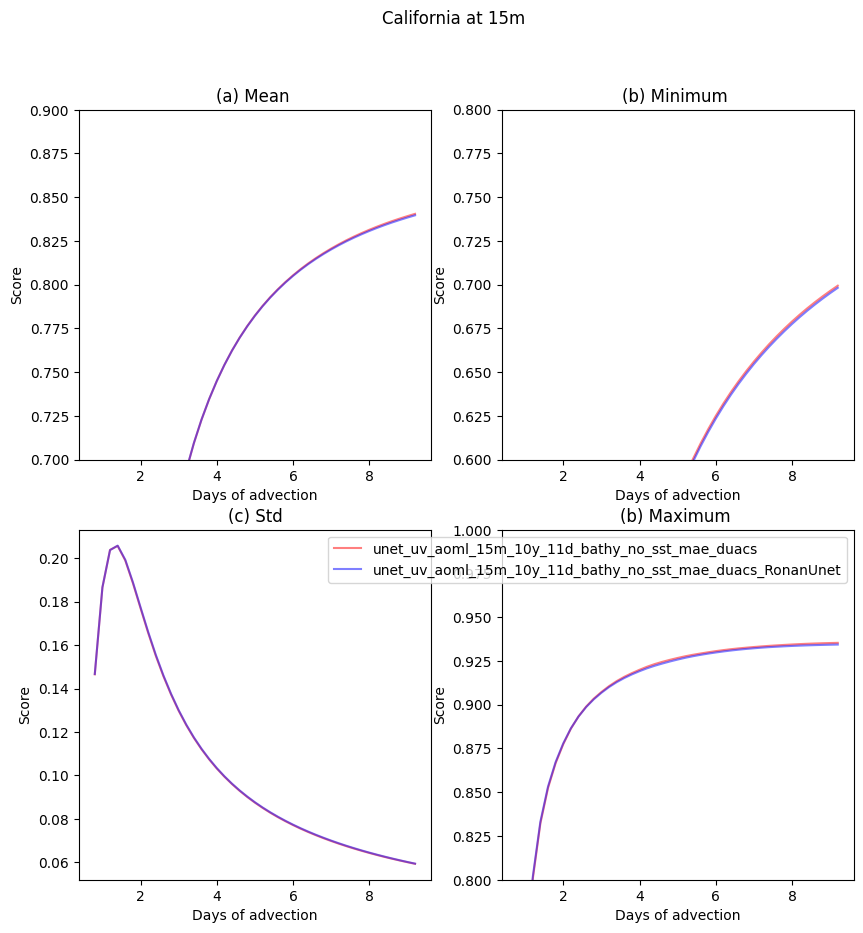

<Figure size 640x480 with 0 Axes>

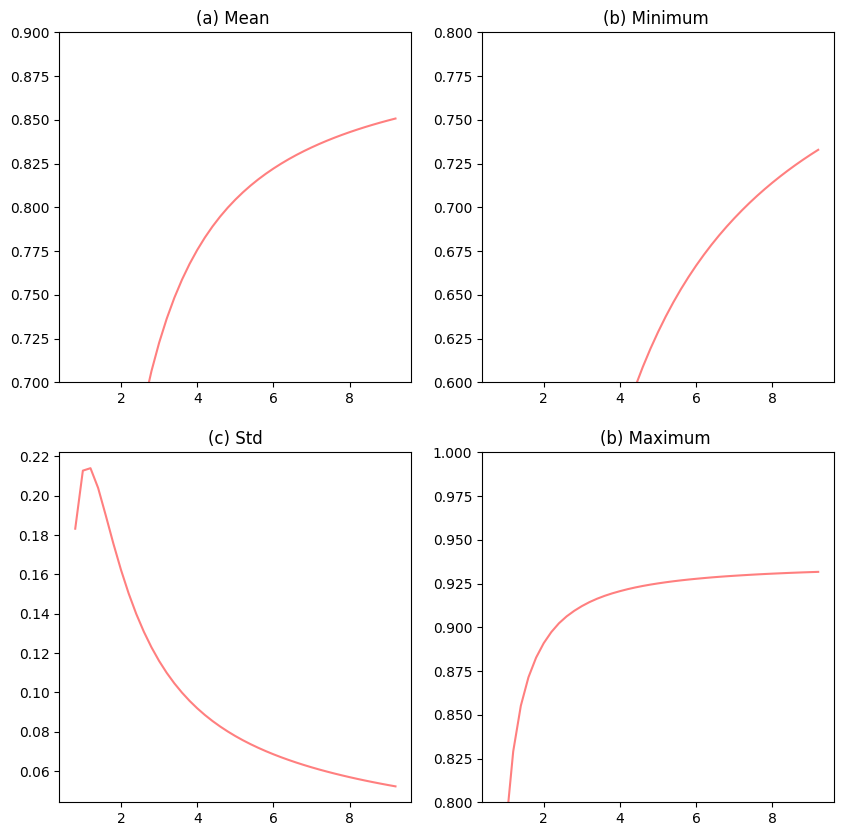

In [ ]:
list_region=["Agulhas","GulfStream","Mediterranean","California","NA"]

list_xp_name=["neurost_sst_ssh_15m_10th",
                "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_neurost" ,
                "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_neurost_u10n",
                
]

list_xp_name=["neurost_sst_ssh_15m_10th",
                "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_neurost" ,
                "unet_uv_aoml_15m_10y_11d_bathy_mae_neurost_MW" ,
                "unet_uv_aoml_15m_10y_11d_bathy_mae_neurost_SST",
                "unet_uv_aoml_15m_10y_11d_bathy_mae_neurost"
]

list_xp_name=["neurost_sst_ssh_15m_10th",
                "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_neurost" ,
                "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_neurost_RonanUnet",
]


list_xp_name=[  ""
                "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs",
                #"unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs_RonanUnet",


]

plot_lagrangian_result(list_xp_name,list_region,depth=15)

<Figure size 640x480 with 0 Axes>

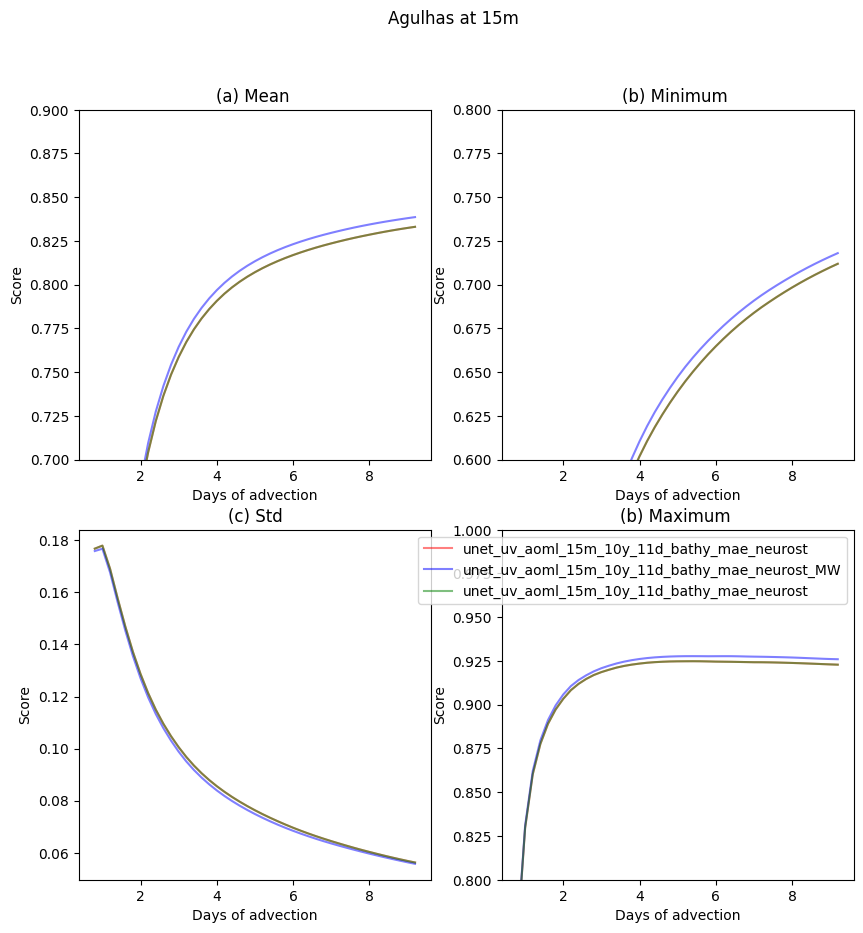

<Figure size 640x480 with 0 Axes>

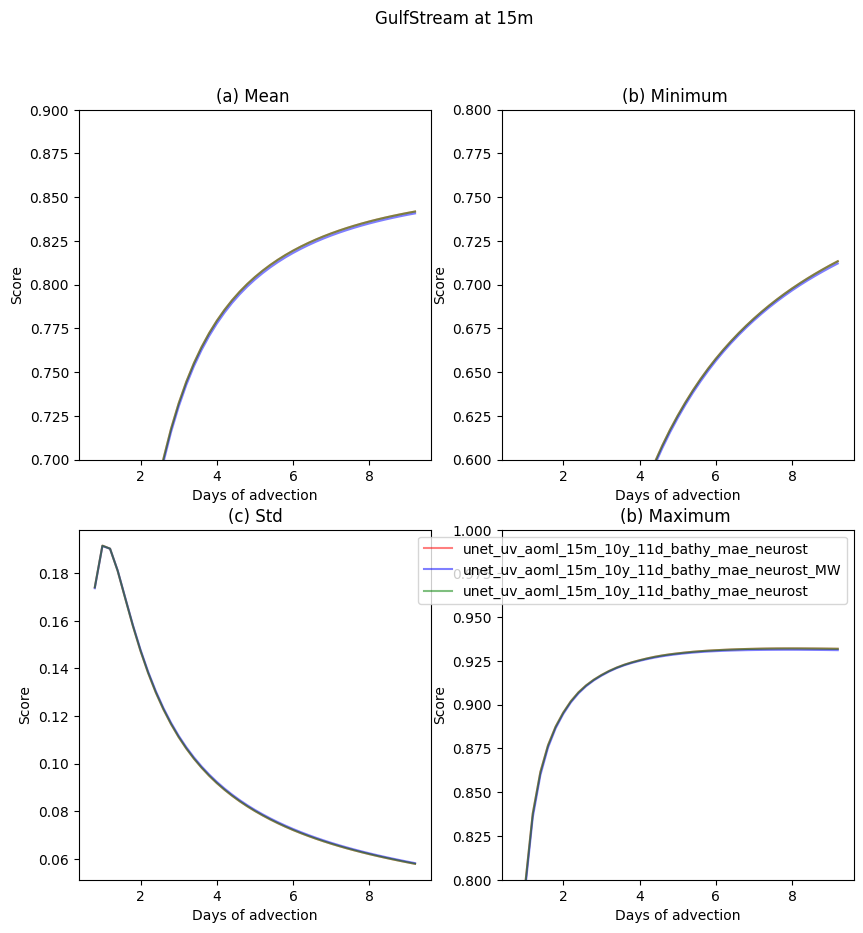

<Figure size 640x480 with 0 Axes>

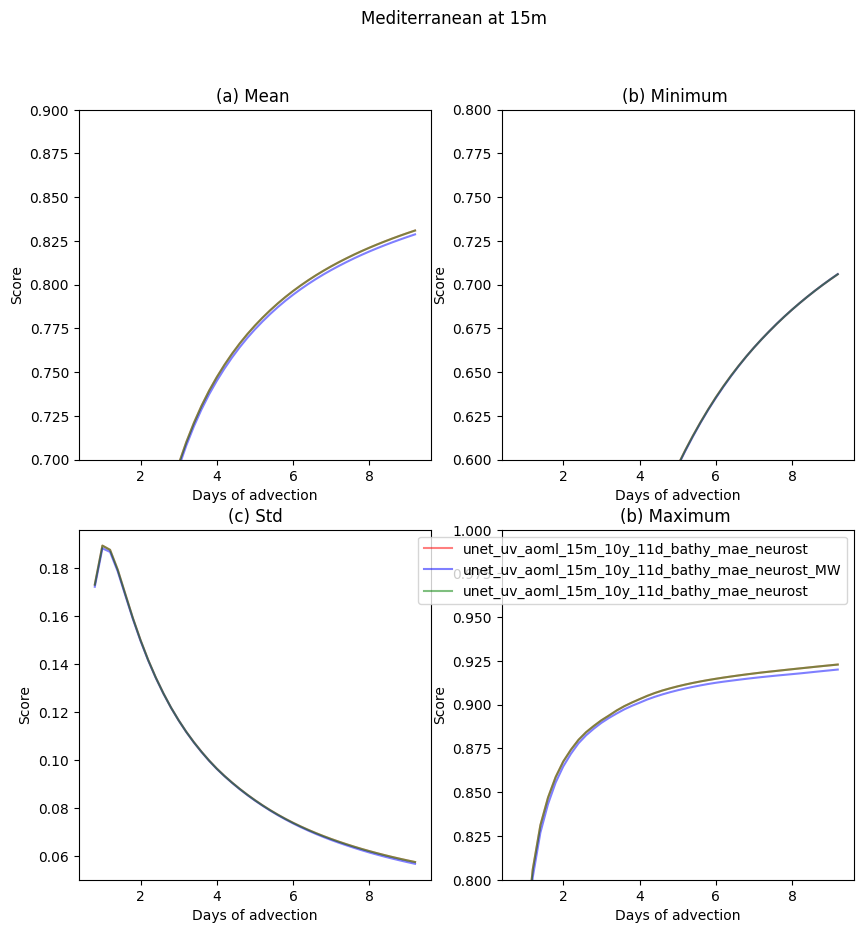

<Figure size 640x480 with 0 Axes>

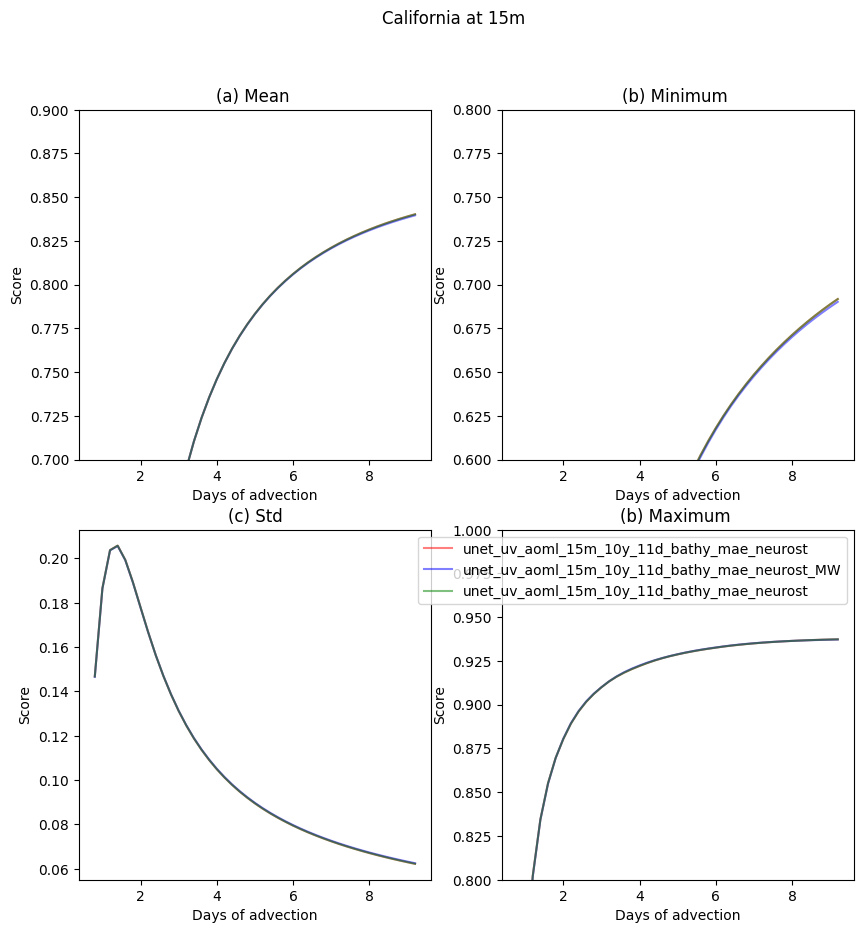

<Figure size 640x480 with 0 Axes>

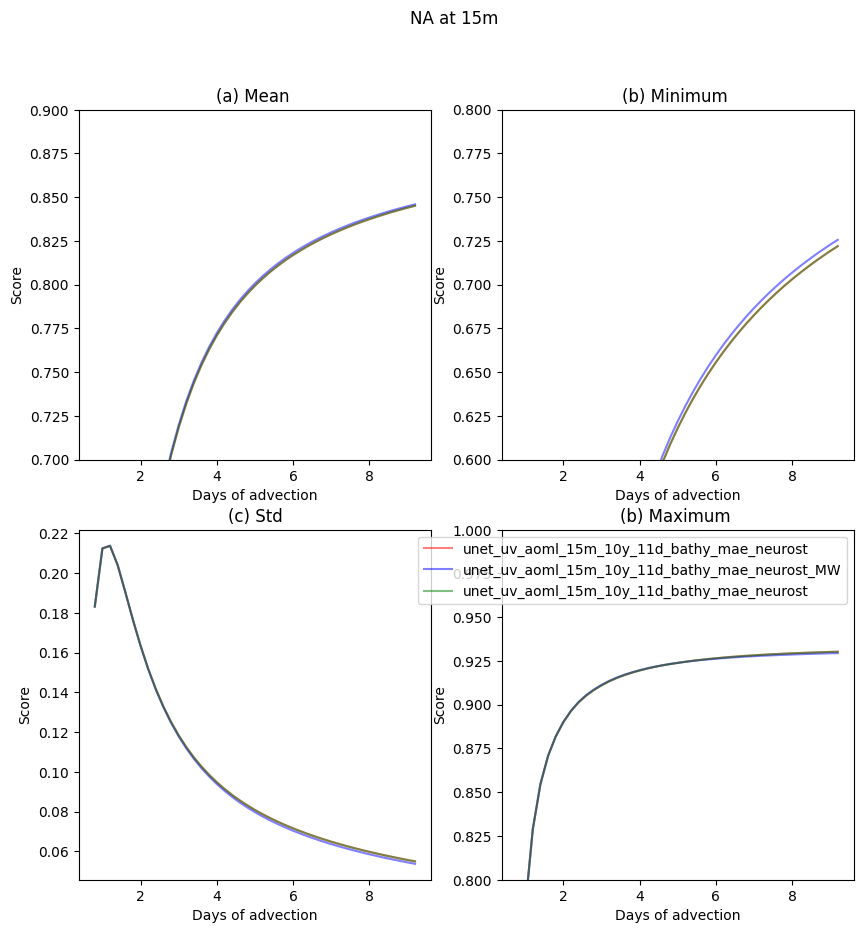

In [ ]:
list_region=["Agulhas","GulfStream","Mediterranean","California","NA"]

list_xp_name=[#"neurost_sst_ssh_15m_10th",
              "duacs_15m_8th",
              "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs",
                #"unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_neurost",
                #"unet_uv_aoml_15m_10y_11d_bathy_mae_neurost"
                #"unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_imt" ,
                #"unet_uv_drifters_aoml_15m_10y_11d_bathy_no_sst_mae_8th_2010_neurost_fine" ,
                #"GC_15m_4th_h",
                #"globcurrent_15m_4th",

]

list_xp_name=[
                "unet_uv_aoml_15m_10y_11d_bathy_mae_neurost",
                "unet_uv_aoml_15m_10y_11d_bathy_mae_neurost_MW",
                "unet_uv_aoml_15m_10y_11d_bathy_mae_neurost"

]

#list_xp_name=["neurost_sst_ssh_15m_10th"]
plot_lagrangian_result(list_xp_name,list_region,depth=15)



<Figure size 640x480 with 0 Axes>

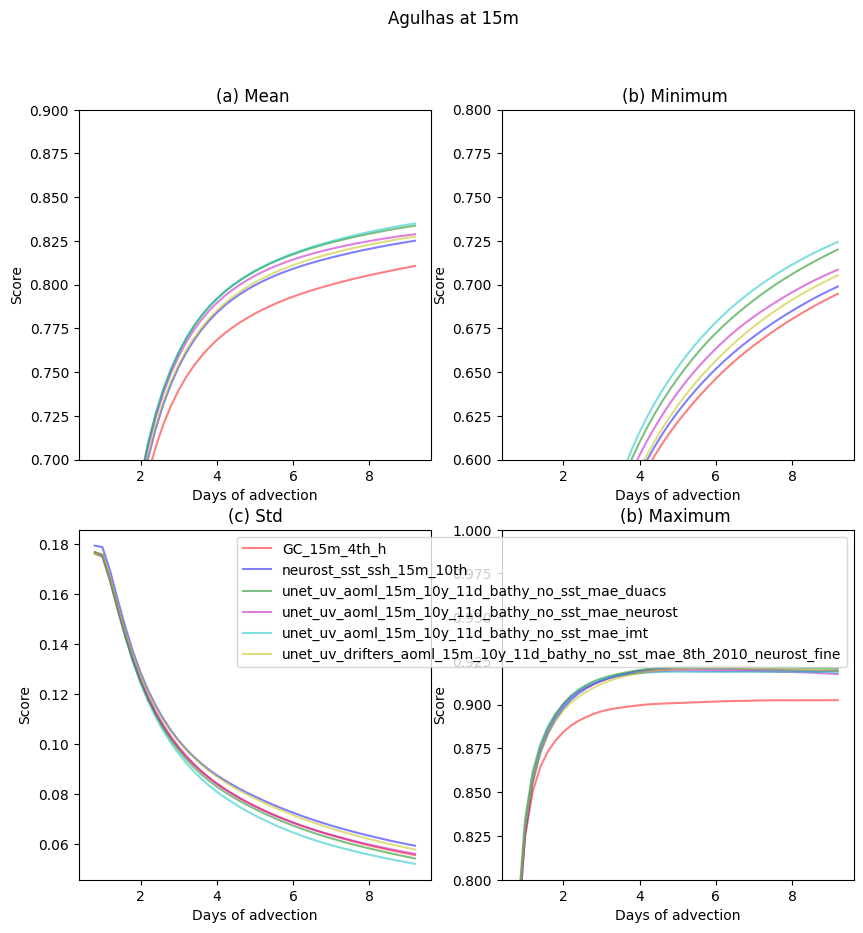

<Figure size 640x480 with 0 Axes>

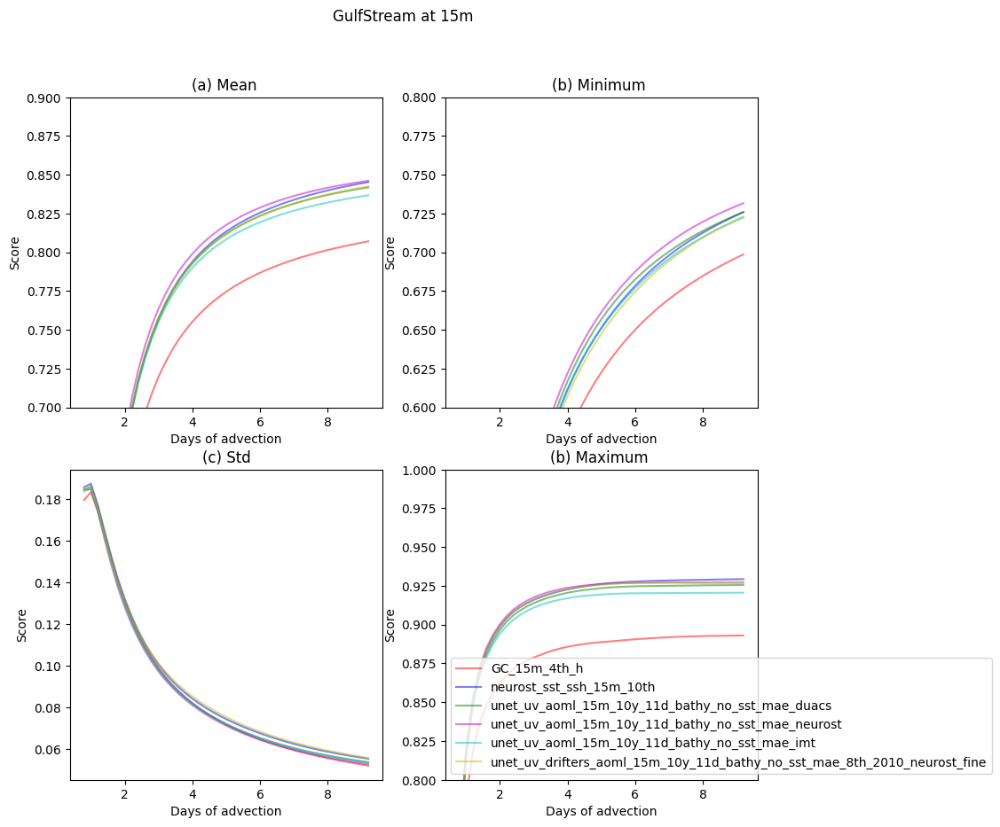

In [4]:
region_list = ["Agulhas","GulfStream"]

list_xp_name=["GC_15m_4th_h",
              "neurost_sst_ssh_15m_10th",
              "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_duacs",
              "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_neurost",
              "unet_uv_aoml_15m_10y_11d_bathy_no_sst_mae_imt",
              "unet_uv_drifters_aoml_15m_10y_11d_bathy_no_sst_mae_8th_2010_neurost_fine"    
              ]

plot_lagrangian_15m(list_xp_name)

<Figure size 640x480 with 0 Axes>

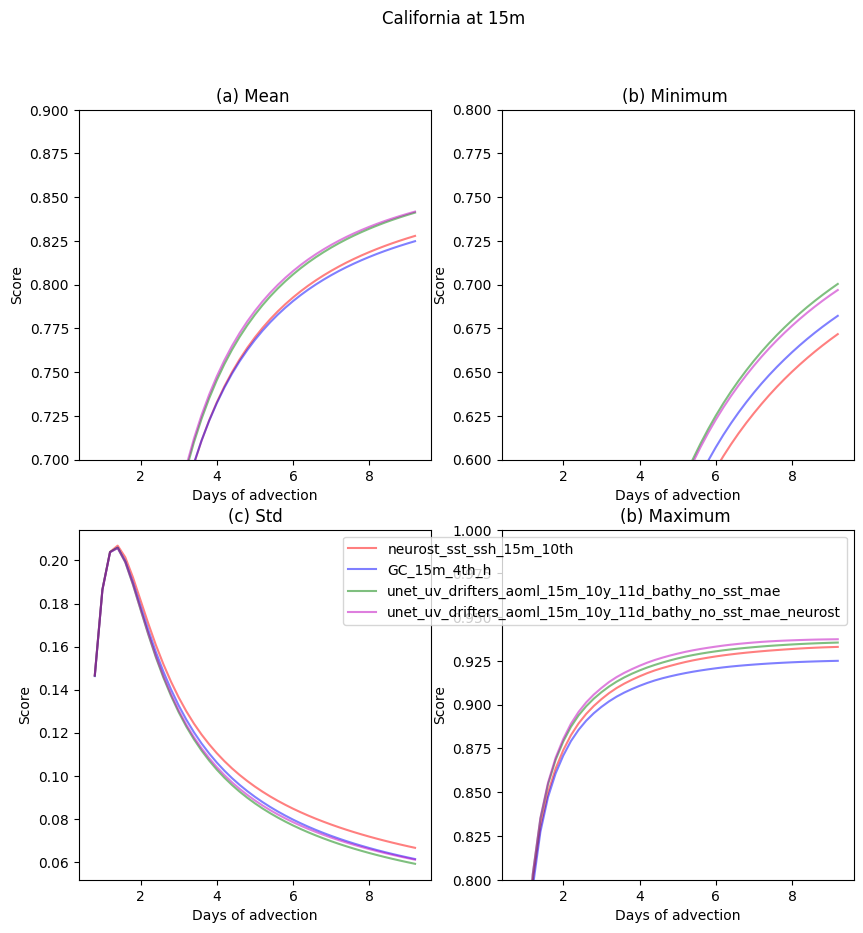

In [2]:
region_list = ["California"]

list_xp_name=["neurost_sst_ssh_15m_10th",
              "GC_15m_4th_h",
              "unet_uv_drifters_aoml_15m_10y_11d_bathy_no_sst_mae",
              "unet_uv_drifters_aoml_15m_10y_11d_bathy_no_sst_mae_neurost",
              ]

plot_lagrangian_15m(list_xp_name)


<Figure size 640x480 with 0 Axes>

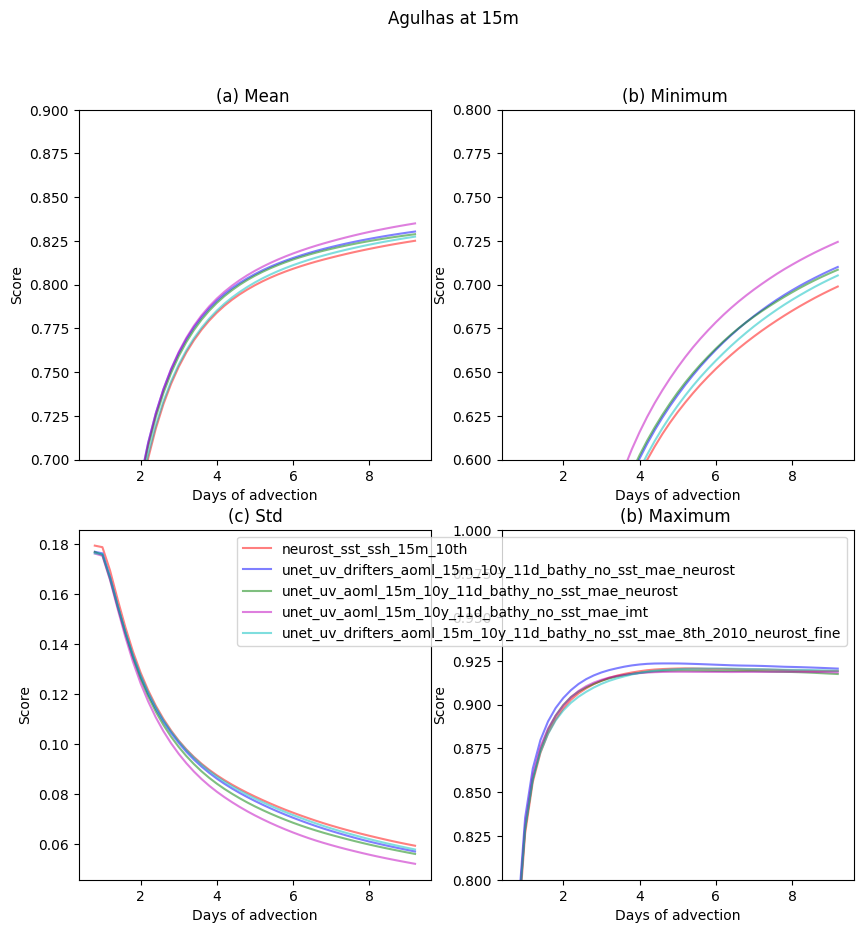

<Figure size 640x480 with 0 Axes>

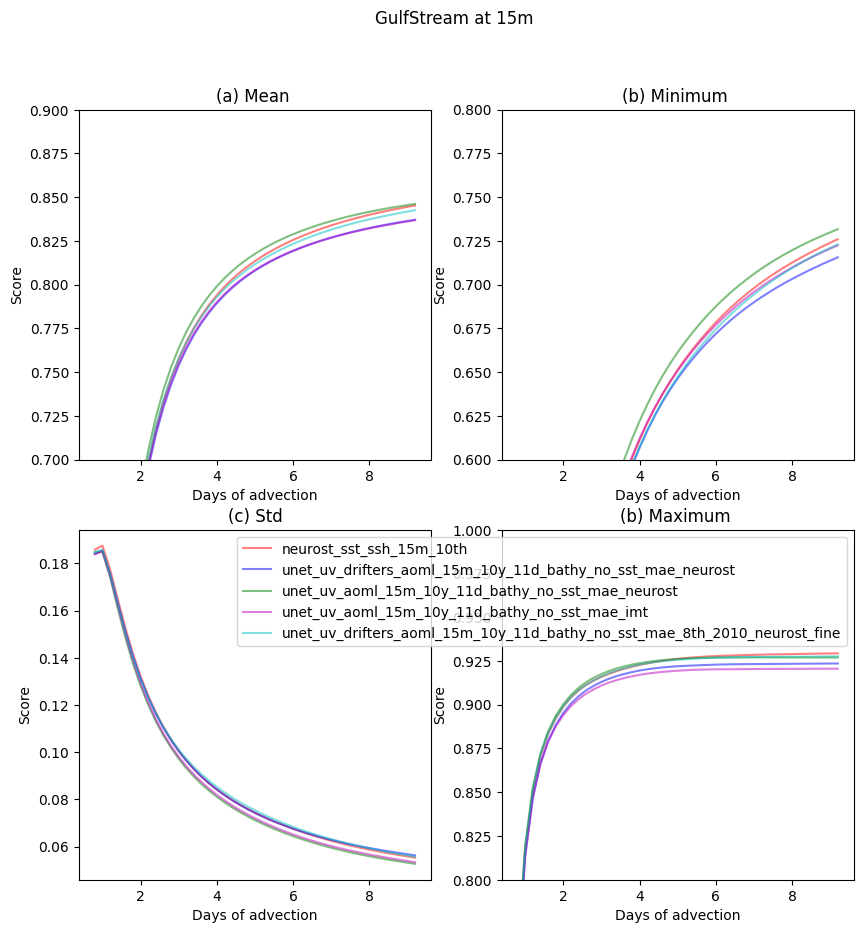

<Figure size 640x480 with 0 Axes>

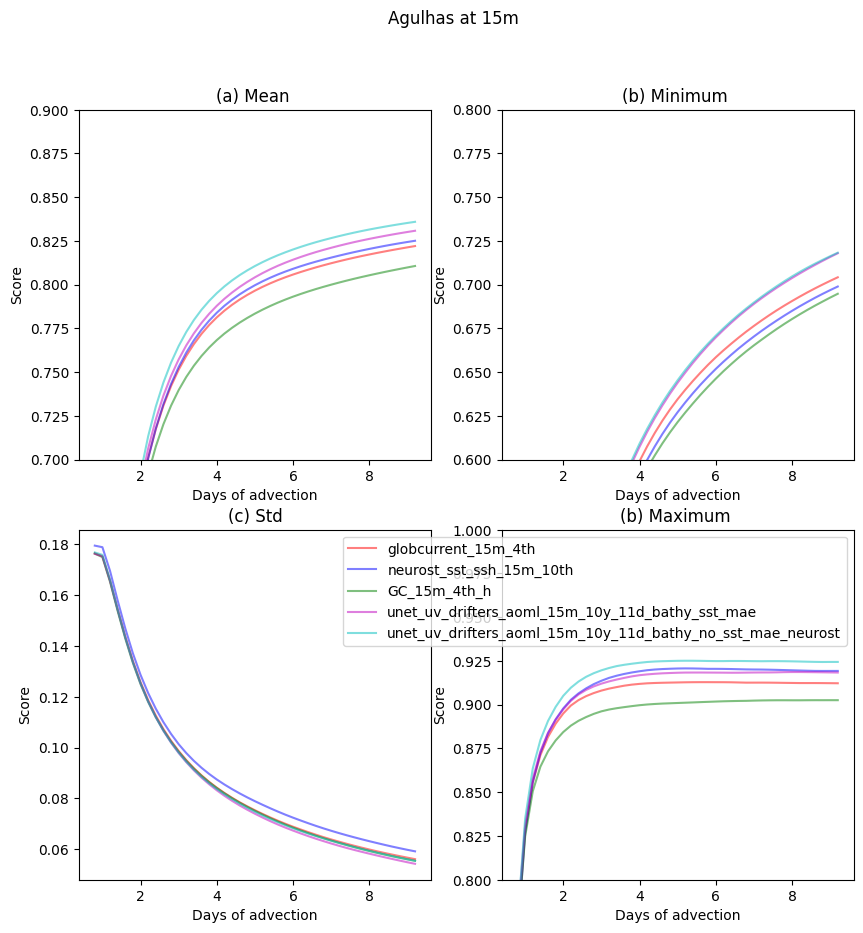

<Figure size 640x480 with 0 Axes>

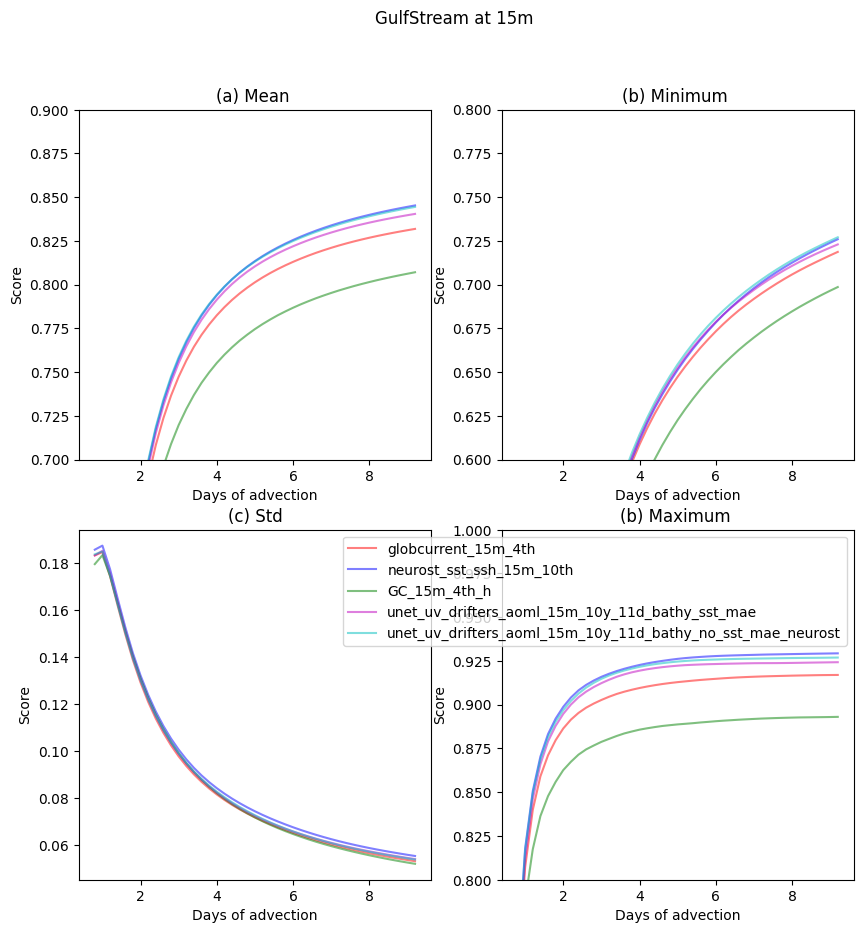

<Figure size 640x480 with 0 Axes>

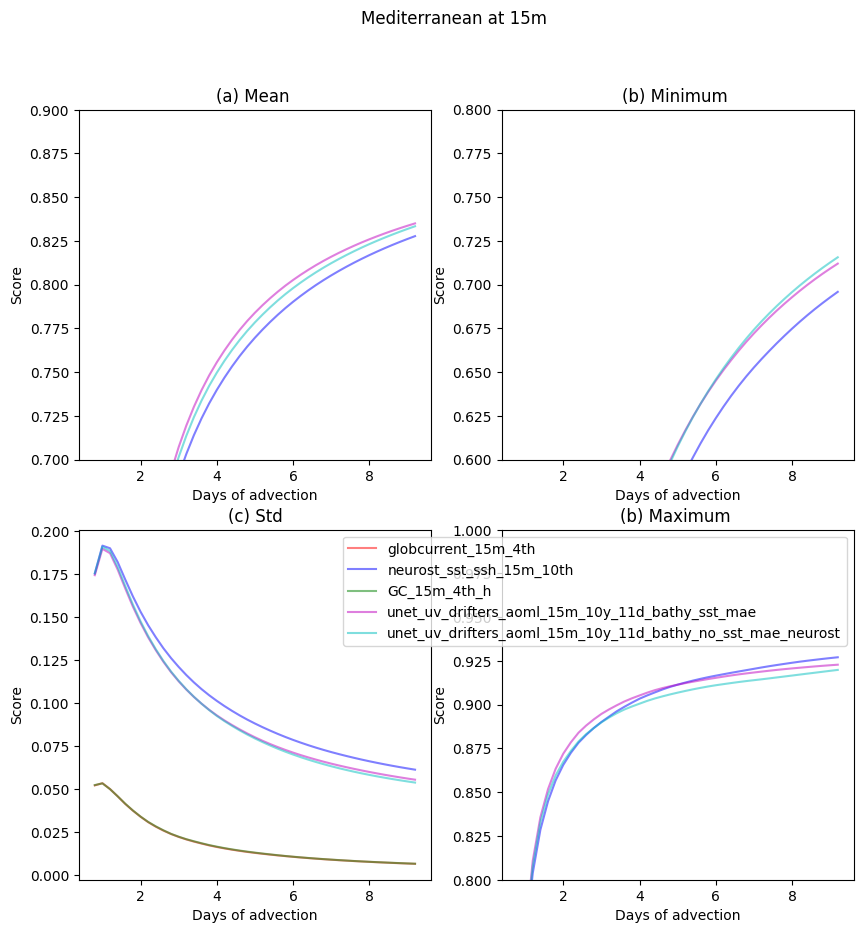

In [7]:
region_list = ["Agulhas","GulfStream","Mediterranean"]

list_xp_name=["globcurrent_15m_4th",
        "neurost_sst_ssh_15m_10th",
        "GC_15m_4th_h",
        "unet_uv_drifters_aoml_15m_10y_11d_bathy_sst_mae",
        "unet_uv_drifters_aoml_15m_10y_11d_bathy_no_sst_mae_neurost"]

plot_lagrangian_15m(list_xp_name)
